# Camera Tests

### Goals:
- Understand the need to preflush and quantify it
- Understand the behvaiour of the horizontal strip in the bias images
- Understand whether darks, bias, lights are read differently or "operate in different modes"
- Compare the difference of performance of the old and new camera
- Investigate whether the flight code is introducing any features (validity of flight code)

### Experimental Procedure:
- Set up both cameras in the princeton balcony with the shutter taped and covered via box for additional darkness
- Run the code once with peltier turned off to find out current internal temprature
- regulate internal temp to something near the naturual temp to avoid variations in external temp
- Take 25 commanded bias images with flight code [set 1]
- Take 25 darks per integration time 10 ,50, 100, 1000, ... [set 2]
- Take 25 darks with bias images with no flush 10s [set 3]
- Take 25 100s darks with no flush and no bias [set 4]
- Take 1s lights with no flush followed by a Bias/Dark 10 times [set 5]
- Warm up set [set6]
- Warm up cam2 [set7]
- Take 25 darks + 25 bias without flight code [Set 8]

### Experiment Log:

- Int temp regulated to -2C with external temp approx 6C
- set1 recording has begun
- set1 complete 
- set2 begun with prebias

In [6]:
from matplotlib import pyplot as plt
import numpy as np, sys, os
from astropy import units as u
import matplotlib
import copy as cp
import math
from scipy.optimize import curve_fit
from astropy.io import fits
import common_tools as ct 
from jupyterthemes import jtplot
jtplot.style(theme='monokai', grid = False)
#plt.style.use('dark_background')
ct.hide_toggle(ttext="imports")

In [237]:
class pset:
    def __init__(self,name,bias=None,dark=None,light=None):
        self.bias = bias
        self.dark = dark
        self.light = light
        self.name = name
        
    def __str__(self):
        return self.name

class dset:
    def __init__(self,name,path):
        self.path = path
        self.name = name
        self.subsets = []
        self.imgs = []
        
        for f in os.listdir(path):
            if os.path.isdir(path + f):
                self.subsets.append(dset(f,path + f+"/"))
            else:
                self.imgs.append(f)
                
        self.subsets = np.array(self.subsets)
        self.imgs =  np.array(self.imgs)
        
        self.exptimes = []
        self.ext_temps = []
        self.int_temps = []
        self.means = []
        self.medians = []
        self.stds = []
        self.times = []
        self.sizes = []
        
        for img in self.imgs:
            with fits.open(path + img) as hdul:
                self.exptimes.append(hdul[0].header["EXPTIME"])
                self.ext_temps.append(hdul[0].header["EXTTEMP"])
                self.int_temps.append(hdul[0].header["INTTEMP"])
                self.means.append(np.mean(hdul[0].data))
                self.medians.append(np.median(hdul[0].data))
                self.stds.append(np.std(hdul[0].data))
                self.times.append(ct.get_time(img))
                self.sizes.append(np.shape(hdul[0].data))
                
        self.exptimeso =  self.exptimes
        self.ext_tempso = self.ext_temps
        self.int_tempso = self.int_temps
        self.meanso = self.means
        self.medianso = self.medians
        self.stdso = self.stds
        self.timeso = self.times
        self.sizeso = self.sizes
        self.imgso =  self.imgs
        
    def __str__(self):
        return self.name
    
    def apply_filter(self,f):
        self.exptimes = self.exptimes[f]
        self.ext_temps = self.ext_temps[f]
        self.int_temps = self.int_temps[f]
        self.means = self.means[f]
        self.medians = self.medians[f]
        self.stds = self.stds[f]
        self.times = self.times[f]
        self.sizes = self.sizes[f]
        self.imgs = self.imgs[f]
        
    def sort_by(self,arr):
        idx = np.argsort(arr)
        self.exptimes = np.take(self.exptimes,idx,axis=0)
        self.ext_temps = np.take(self.ext_temps,idx,axis=0)
        self.int_temps = np.take(self.int_temps, idx,axis=0)
        self.means = np.take(self.means, idx,axis=0)
        self.medians = np.take(self.medians,idx,axis=0)
        self.stds = np.take(self.stds,idx,axis=0)
        self.times = np.take(self.times,idx,axis=0)
        self.sizes = np.take(self.sizes,idx,axis=0)
        self.imgs = np.take(self.imgs,idx,axis=0)
        
    def clear_filters(self):
        self.exptimes =  self.exptimeso
        self.ext_temps = self.ext_tempso
        self.int_temps = self.int_tempso
        self.means = self.meanso
        self.medians = self.medianso
        self.stds = self.stdso
        self.times = self.timeso
        self.sizes = self.sizeso
        self.imgs = slef.imgso
        
ct.hide_toggle(ttext="set class")

## Set 1 (Flushed Commanded Bias Images)

In [243]:
base = "/data2/superbit_2019_camtest/"
# Set1
set1 = pset("set1",bias=dset("set1 bias",base+"BiasImages/set1/"))

In [244]:
set1.bias.sort_by(set1.bias.times)

In [245]:
print("Image Sizes:")
print(set1.bias.sizes)
        
ct.hide_toggle()

Image Sizes:
[[4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]
 [4383 6575]]


So the first thing we note here is that this is not a full frame despite requesting a full frame I get a subframe, this possibly points towards a code bug!

In [186]:
set1_mean = ct.master_mean(set1.bias.imgs,[],set1.bias.path,imsize=(4383,6575))

(1114.2227656963614, 1112.24, 14.225636822930163)


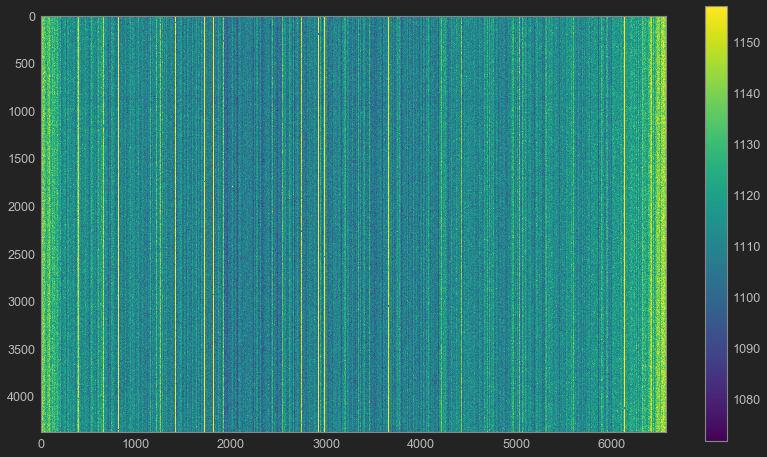

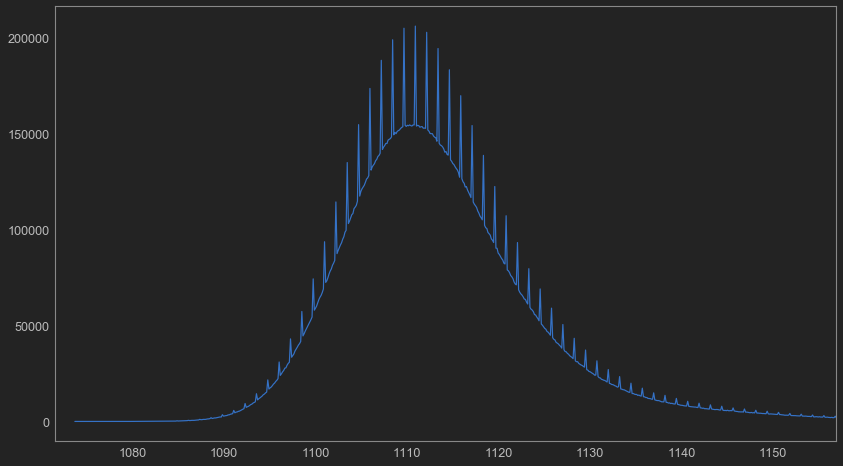

In [190]:
ct.plotimg(set1_mean)
ct.plothist(set1_mean,sig=3,bins=5000,report=False)

Interstingly there is no horizontal bar however we cant really trust these bias images since we have already shown that subframes are read differently from full frames so this is possibly not represntitive. Note that its missing the bright column 4356 as well as the horizointal strip feature.

## Set 2 (Assortment of Preflushed Darks)

In [238]:
# Set2
set2 = pset("set2",bias=dset("set2 bias",base+"BiasImages/set2/"),dark=dset("set2 darks",base+"DarkImages/set2/"))

In [317]:
print "Dark Subsets (ms):"
for i in range(len(set2.dark.subsets)): print set2.dark.subsets[i].name
print ""
print "Bias Subsets (ms):"
for i in range(len(set2.bias.subsets)): print set2.bias.subsets[i].name

Dark Subsets (ms):
1000
555
100
100000
50
10

Bias Subsets (ms):
555
50
10


In [247]:
print("Bias Image Sizes:")
set2.bias.subsets[0].sort_by(set2.bias.subsets[0].times)
print set2.bias.subsets[0].name ,":", set2.bias.subsets[0].sizes
print ""
set2.bias.subsets[1].sort_by(set2.bias.subsets[1].times)
print set2.bias.subsets[1].name ,":", set2.bias.subsets[1].sizes 
print ""
set2.bias.subsets[2].sort_by(set2.bias.subsets[2].times)
print set2.bias.subsets[2].name ,":", set2.bias.subsets[2].sizes 
ct.hide_toggle()

Bias Image Sizes:
555 : [[4383 6575]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]]

50 : [[4383 6575]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]]

10 : [[4383 6575]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]


### 555 (31262ms Darks with pre img bias)

#### Bias

It seems like the first bias associated with the first dark in every set is actually a subframe the same size as the commanded bias images full frames which again hints at a code bug

In [259]:
set2_555_bias_mean = ct.master_mean(set2.bias.subsets[0].imgs[1:],[],set2.bias.subsets[0].path)

(1114.50323477591, 1113.0, 29.240430524531728)
(1118.86716902109, 1116.7916666666667, 17.571656739736405)
(4.040924381764191, 5.2083333333332575, 32.4944966045469)
(1118.3385168659108, 1116.0, 31.224286826867232)


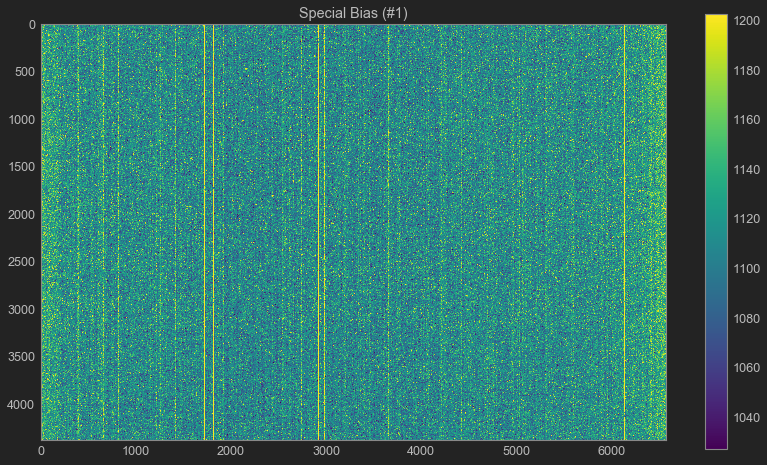

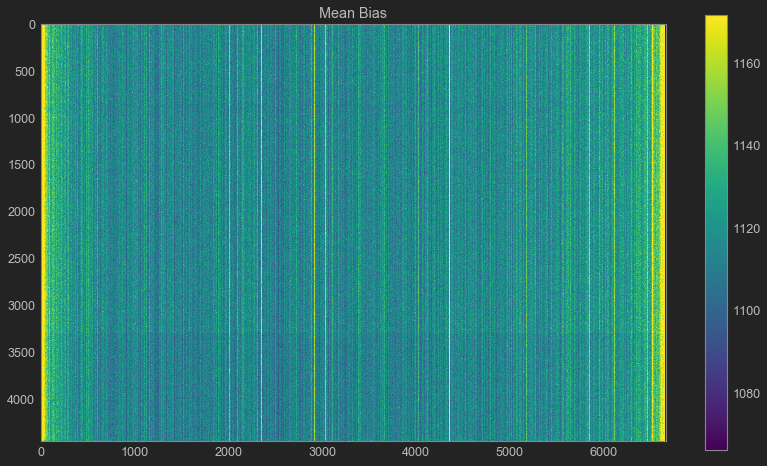

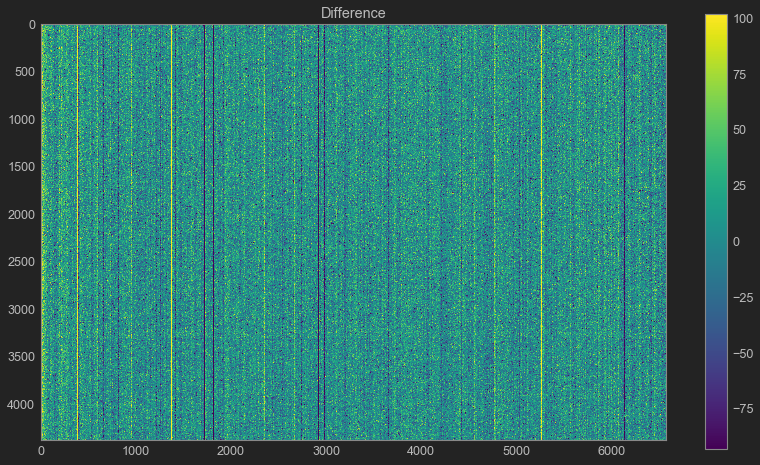

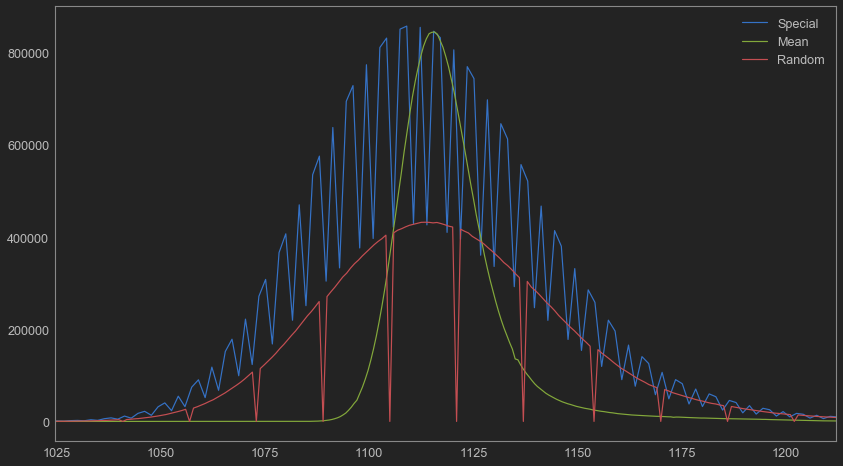

In [306]:
with fits.open(set2.bias.subsets[0].path + set2.bias.subsets[0].imgs[0]) as hdul:
    ct.plotimg(hdul[0].data,title="Special Bias (#1)")
    ct.plotimg(set2_555_bias_mean, title="Mean Bias")
    ct.plotimg( set2_555_bias_mean[0:4383,0:6575] - hdul[0].data,title="Difference")
    ct.plothist(hdul[0].data,sig=3,bins=1200,report=False,label="Special",title="Histogram of Special Bias, A Random Bias, and Master Bias")
    ct.plothist(set2_555_bias_mean,nfig=False,sig=3,bins=1200,report=False,label="Mean")

with fits.open(set2.bias.subsets[0].path + set2.bias.subsets[0].imgs[1]) as hdul:
    ct.plothist(hdul[0].data,sig=3,bins=1200,label="Random",nfig=False)
ct.hide_toggle()

It is now very clear that those subframes behave differrntly they are not only missing the horiziontal strip and the bright column but also have different shape to them

#### Darks

In [307]:
set2.dark.subsets[1].sort_by(set2.dark.subsets[1].times)
print "Dark Image Sizes:"
print set2.dark.subsets[1].sizes
ct.hide_toggle()

Dark Image Sizes:
[[4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]
 [4453 6665]]


All the dark images are the expected "full frame" size

In [293]:
set2_555_dark_mean = ct.master_mean(set2.dark.subsets[1].imgs,[],set2.dark.subsets[1].path)

(1116.736218372132, 1114.0, 92.31401236693547)
(-2.1309506489579872, -2.8266666666668243, 91.0252500494967)


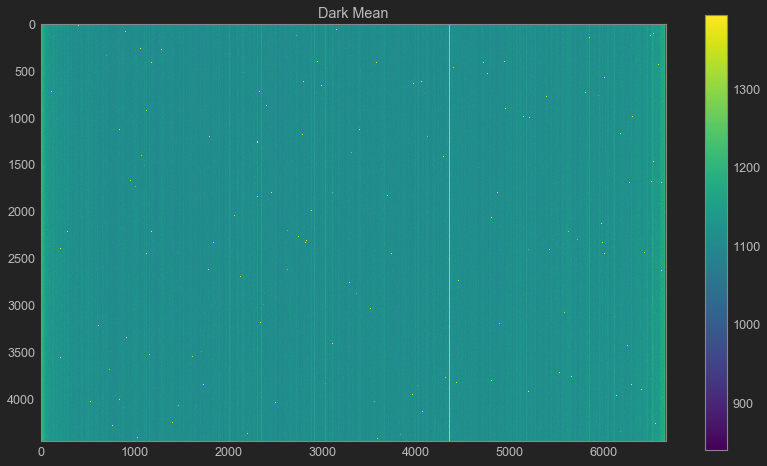

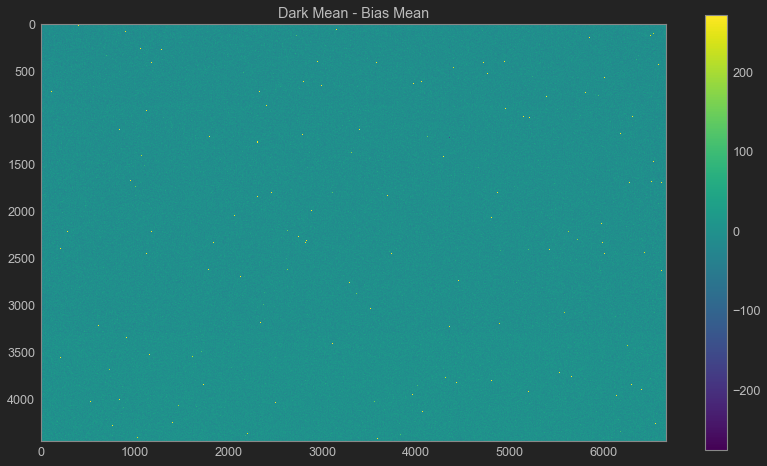

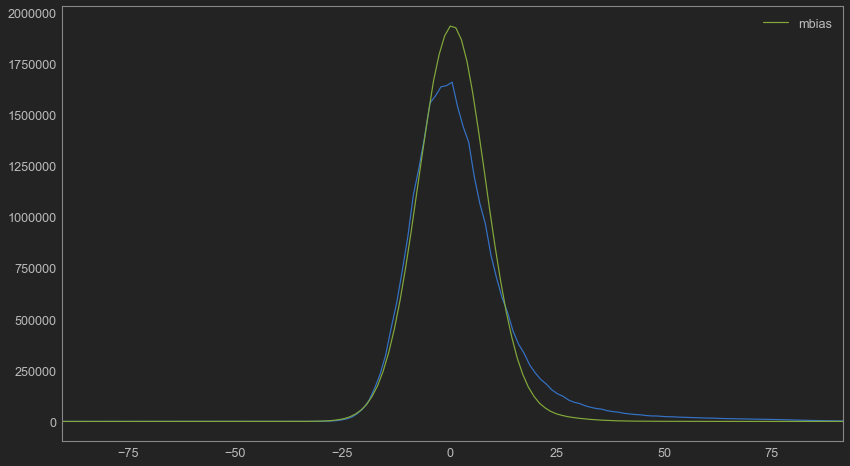

In [311]:
ct.plotimg(set2_555_dark_mean,title="Dark Mean" )
ct.plotimg(set2_555_dark_mean - set2_555_bias_mean ,title="Dark Mean - Bias Mean")
ct.plothist(set2_555_dark_mean - np.median(set2_555_dark_mean),bins=50000,report=False)
ct.plothist((set2_555_dark_mean - set2_555_bias_mean)- np.median(set2_555_dark_mean - set2_555_bias_mean),bins=50000,report=False,nfig=False,label="mbias")
ct.hide_toggle()

Note that despite the fact that subtracting the mean bias does indeed clean the image / improve it it is clear tha the dark does not include the horizontal strip feature is that strip gets undersubtracted in the process! Before I continue with methodlogical analysis we will first take a peak at a set that doesnt have a prebias taken.

### 100 (100ms Darks set with no prebias) vs 10 (10ms Darks set with bias)

In [326]:
set2_100_dark_mean = ct.master_mean(set2.dark.subsets[2].imgs[1:],[],set2.dark.subsets[2].path)
set2_10_bias_mean = ct.master_mean(set2.bias.subsets[2].imgs[1:],[],set2.bias.subsets[2].path)
set2_10_dark_mean = ct.master_mean(set2.dark.subsets[5].imgs[1:],[],set2.dark.subsets[5].path)

(1118.0189357144463, 1115.9166666666667, 17.618757957778136)
(1115.1799561893636, 1113.0833333333333, 17.431662527494648)
(1117.2370598558573, 1115.125, 17.61899625173487)
(0.7818758585896207, 0.7916666666665151, 7.743043068216343)
(-2.057103666496009, -2.041666666666515, 7.637925717749689)
(1.630109165232017, 1.625, 7.627757538030649)


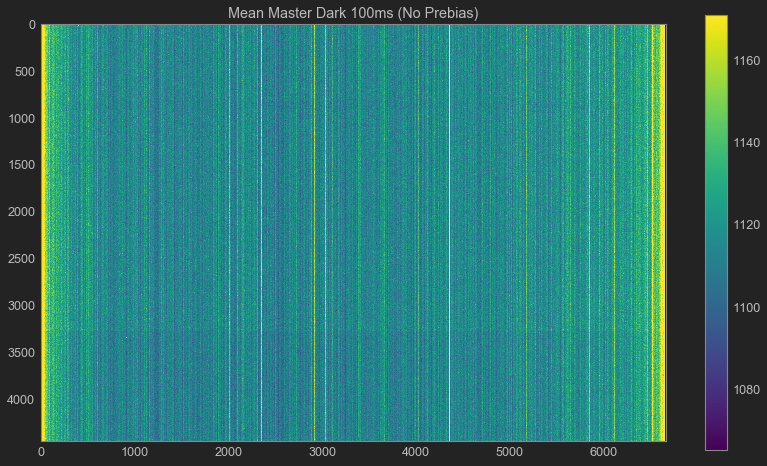

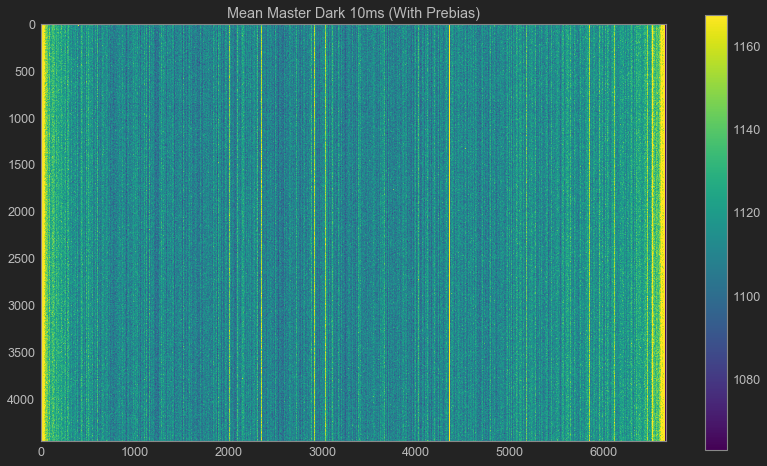

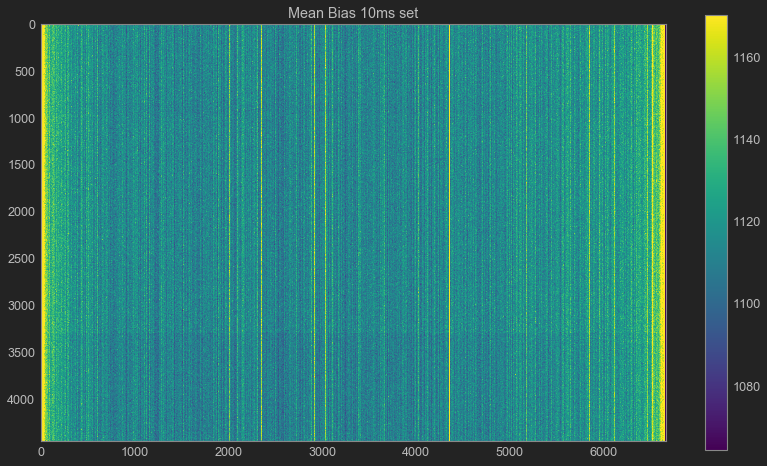

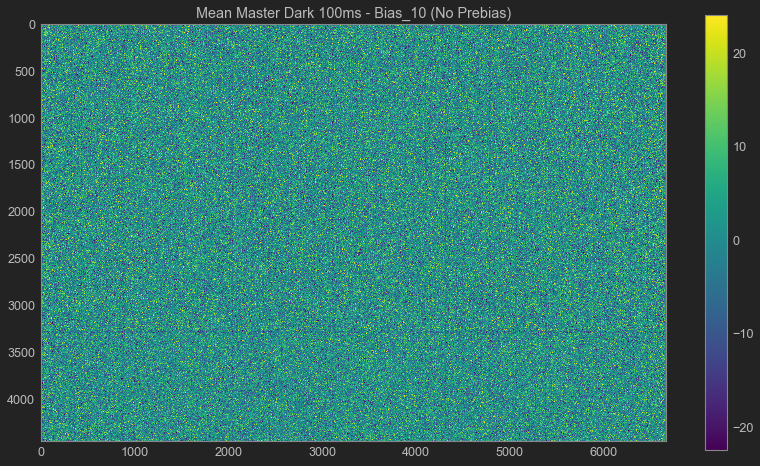

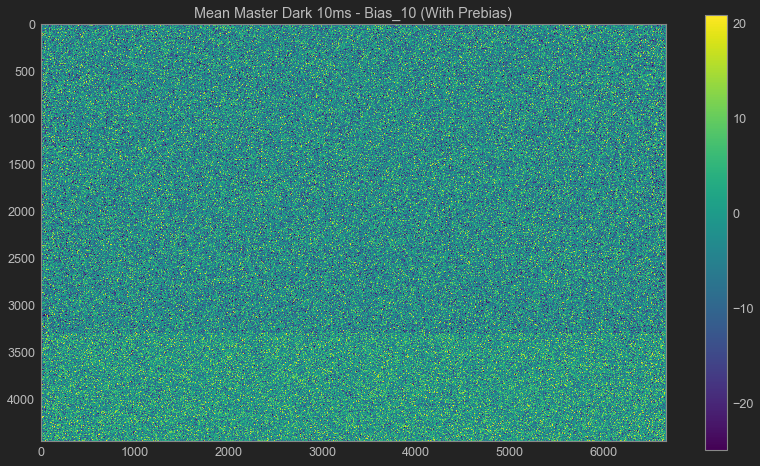

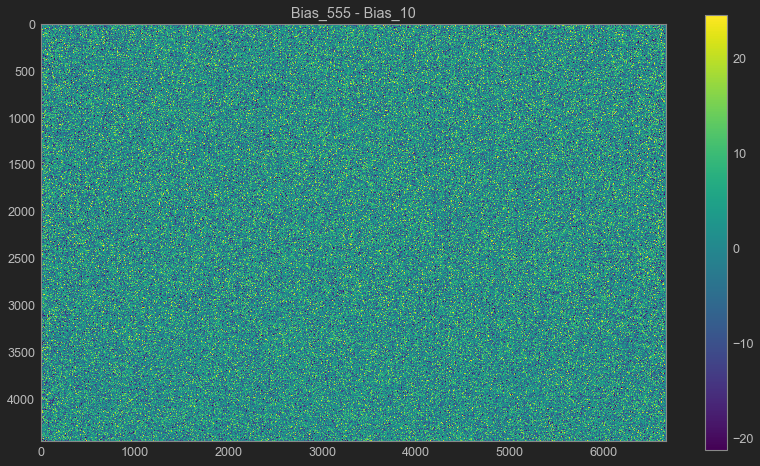

In [329]:
ct.plotimg(set2_100_dark_mean,title="Mean Master Dark 100ms (No Prebias)")
ct.plotimg(set2_10_dark_mean,title="Mean Master Dark 10ms (With Prebias)")
ct.plotimg(set2_10_bias_mean,title="Mean Bias 10ms set")
ct.plotimg(set2_100_dark_mean - set2_10_bias_mean,title="Mean Master Dark 100ms - Bias_10 (No Prebias)")
ct.plotimg(set2_10_dark_mean - set2_10_bias_mean ,title="Mean Master Dark 10ms - Bias_10 (With Prebias)")
ct.plotimg(set2_555_bias_mean - set2_10_bias_mean ,title="Bias_555 - Bias_10")
ct.hide_toggle()

Weirdly enough when we stopped taking prebias images the bias features appeared in the dark.. The horizontal strip is not visible in the 10ms darks despite being in theory just a bias while are clearly there in the 100ms darks since we didnt take a pre bias? so this indicates one of two things either pre biasing is doing some sort of flushing to that horizontal feature or there is a code bug resulting in a different read mode for images with pre bias and images without ? So I guess it might not be a temprature or integration time thing

In [330]:
set2_100000_dark_mean = ct.master_mean(set2.dark.subsets[3].imgs[1:],[],set2.dark.subsets[3].path)

(1117.809039496006, 1115.0416666666667, 98.18855313007386)
(-0.24307494246681238, -1.0625000000002274, 96.9117856562784)
(2.6290833066452066, 1.8333333333332575, 96.91903248627749)
(3.3971803143670427, 2.5699999999999363, 98.10850457718212)
(3.3971803143670427, 2.5699999999999363, 98.10850457718212)


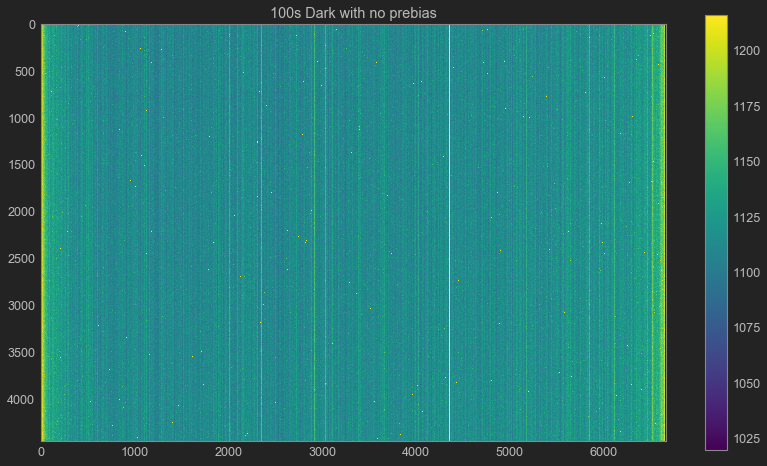

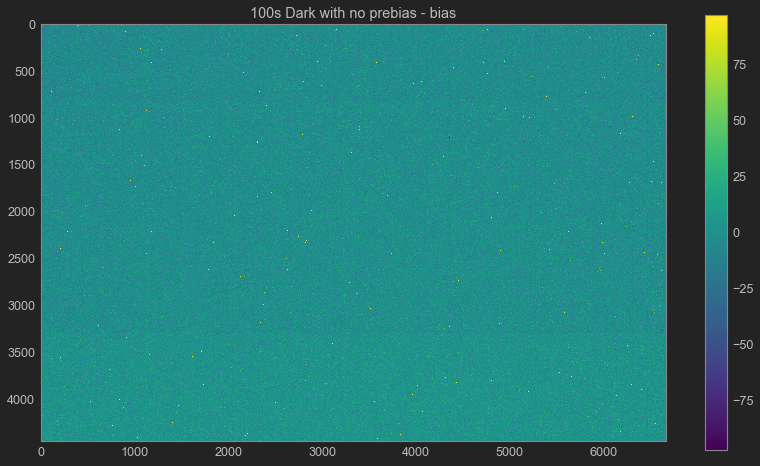

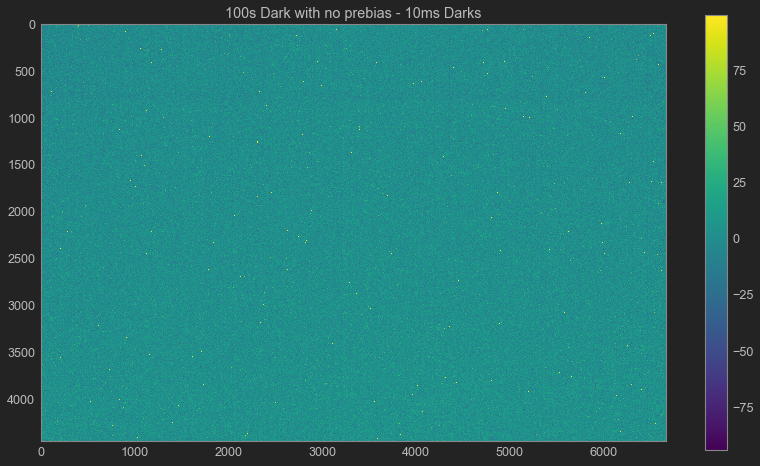

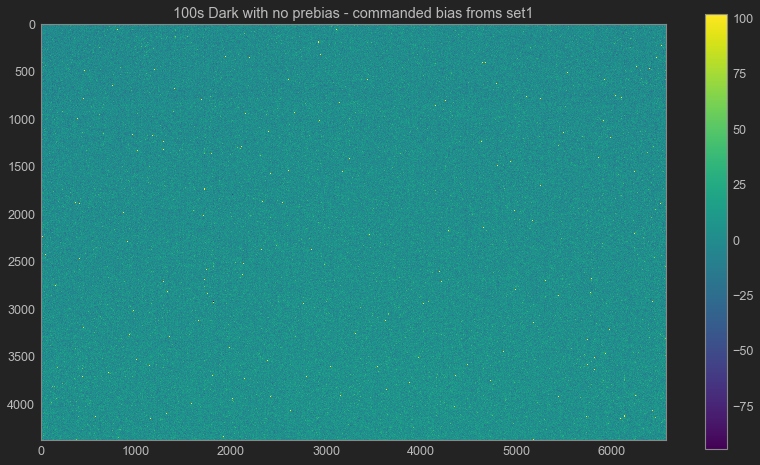

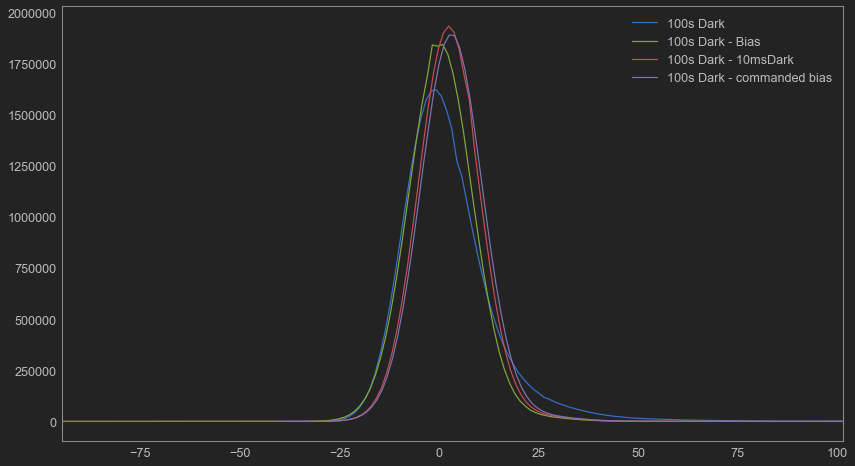

In [421]:
ct.plotimg(set2_100000_dark_mean,title="100s Dark with no prebias",sig=1)
ct.plotimg(set2_100000_dark_mean - (set2_10_bias_mean + set2_555_bias_mean)/2,title="100s Dark with no prebias - bias",sig=1)
ct.plotimg(set2_100000_dark_mean - set2_10_dark_mean ,title="100s Dark with no prebias - 10ms Darks",sig=1)
ct.plotimg(set2_100000_dark_mean[35:4453-35,45:6665-45] - set1_mean,sig=1,title="100s Dark with no prebias - commanded bias froms set1")
ct.plothist(set2_100000_dark_mean[35:4453-35,45:6665-45]-np.median(set2_100000_dark_mean[35:4453-35,45:6665-45]),label="100s Dark",report=False,bins=50000)
ct.plothist(set2_100000_dark_mean[35:4453-35,45:6665-45] - set2_10_bias_mean[35:4453-35,45:6665-45] ,label="100s Dark - Bias",nfig=False,report=False,bins=50000)
ct.plothist(set2_100000_dark_mean[35:4453-35,45:6665-45] - set2_10_dark_mean[35:4453-35,45:6665-45],label="100s Dark - 10msDark",nfig=False,report =False,bins=50000)
ct.plothist(set2_100000_dark_mean[35:4453-35,45:6665-45] - set1_mean,label="100s Dark - commanded bias",nfig=False,report =True,bins=50000)
ct.hide_toggle()

For some reason the 100s integration does not have the strip despite not having prebias images. Note however that subtracting the 10ms darks gives us a different smaller horiztonal strip at the top rather than the bottom. We also note that based on the histograms subtracting the featurful bias seems to perform better than the 10ms darks, and it is clear that the commanded bias is just wrong.

In [355]:
set2_1000_dark_mean = ct.master_mean(set2.dark.subsets[0].imgs[1:],[],set2.dark.subsets[0].path)
set2_50_dark_mean = ct.master_mean(set2.dark.subsets[4].imgs[1:],[],set2.dark.subsets[4].path)
set2_50_bias_mean = ct.master_mean(set2.bias.subsets[1].imgs[1:],[],set2.bias.subsets[1].path)

(1117.977110106741, 1115.875, 17.710753705806603)
(1116.1031039873133, 1114.0, 17.43250737864178)
(1118.181293980299, 1116.0833333333333, 17.619666514545095)


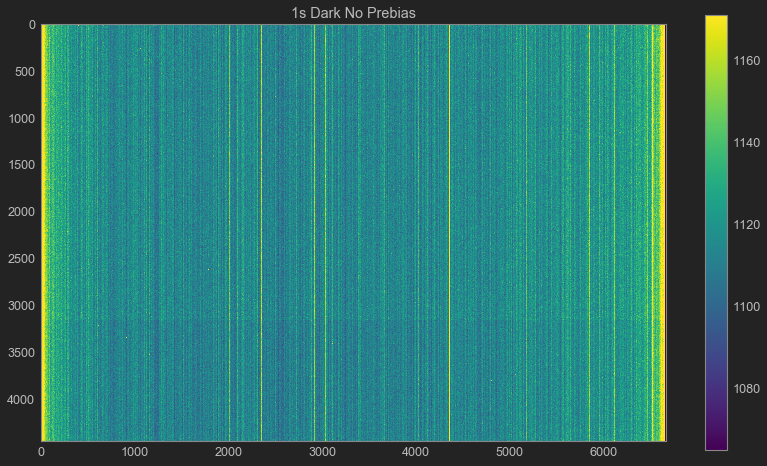

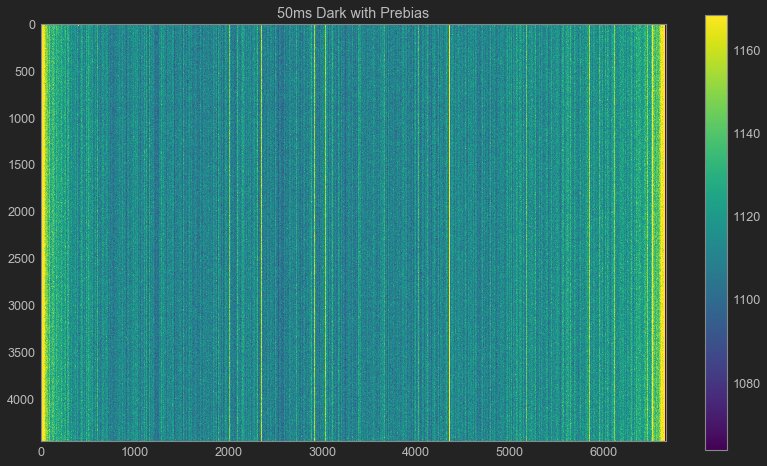

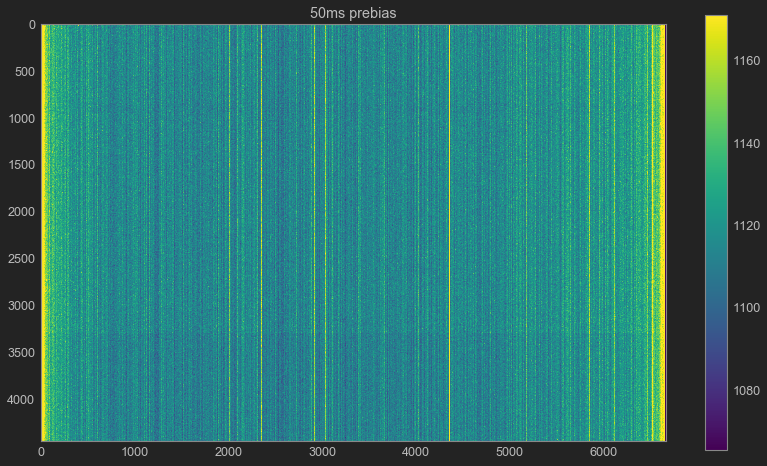

In [357]:
ct.plotimg(set2_1000_dark_mean,title="1s Dark No Prebias")
ct.plotimg(set2_50_dark_mean,title="50ms Dark with Prebias")
ct.plotimg(set2_50_bias_mean,title="50ms prebias")
ct.hide_toggle()

Again the trend continues so prebias image deffinetly has an effect

## Set 3 and 4
- 25 darks with bias images with no flush 10s [set 3]
- 25 100s darks with no flush and no bias [set 4]

In [362]:
# Set3
set3 = pset("set3",bias=dset("set3 bias",base+"BiasImages/set3/"),dark=dset("set3 darks",base+"DarkImages/set3/"))

#Set4
set4 = pset("set4",dark=dset("set4 darks",base+"DarkImages/set4/"))

In [374]:
set3_bias_mean = ct.master_mean(set3.bias.imgs[1:],[],set3.bias.path)
set3_dark_mean = ct.master_mean(set3.dark.imgs[1:],[],set3.dark.path)
set4_mean = ct.master_mean(set4.dark.imgs[1:],[],set4.dark.path)

(1117.1164003006684, 1115.0, 17.40000730975584)
(1115.7765648505679, 1113.5416666666667, 38.38394449878541)
(1118.1015474534481, 1115.3333333333333, 98.05480521599807)


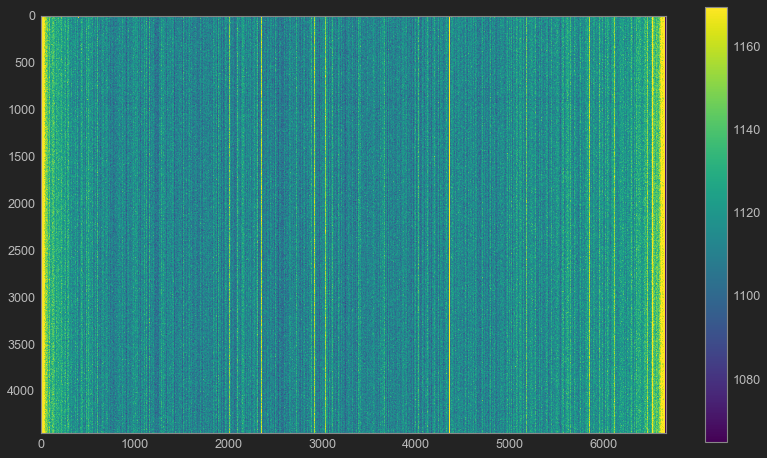

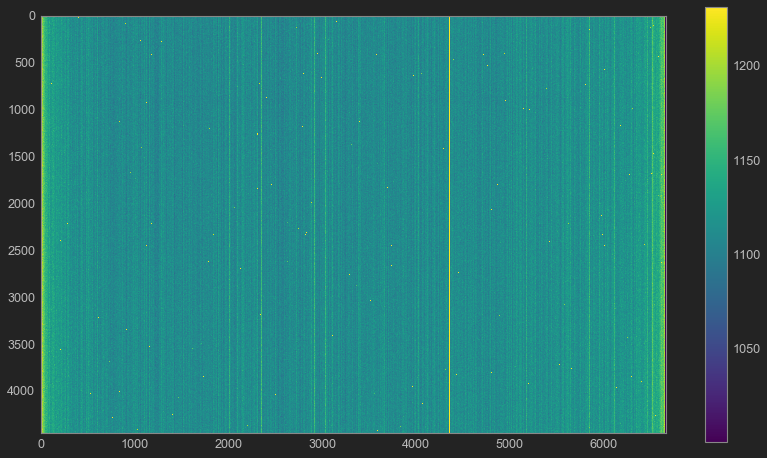

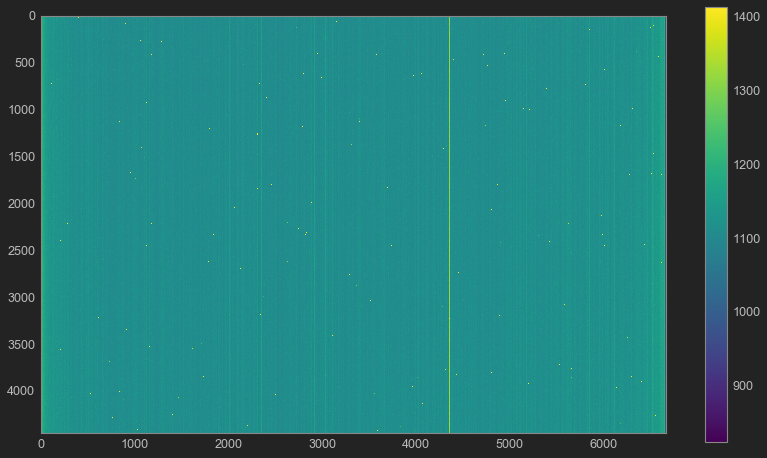

In [375]:
ct.plotimg(set3_bias_mean)
ct.plotimg(set3_dark_mean)
ct.plotimg(set4_mean)

## Set5
- Take 1s lights with no flush followed by a Bias/Dark 10 times [set 5]

In [381]:
# Set5
set5 = pset("set5",bias=dset("set5 bias",base+"BiasImages/set5/"),light=dset("set5 light",base+"ScienceImages/"))

In [390]:
set5.bias.sort_by(set5.bias.times)
set5_bias_mean = ct.master_mean(set5.bias.imgs[1:],[],set5.bias.path,imsize=(4383,6575))
set5_light_mean = ct.master_mean(set5.light.imgs[1:],[],set5.light.path,imsize=(4383,6575))

(-0.5201361971460782, -0.5866666666668152, 10.022162331907156)
(65535.0, 65535.0, 0.0)


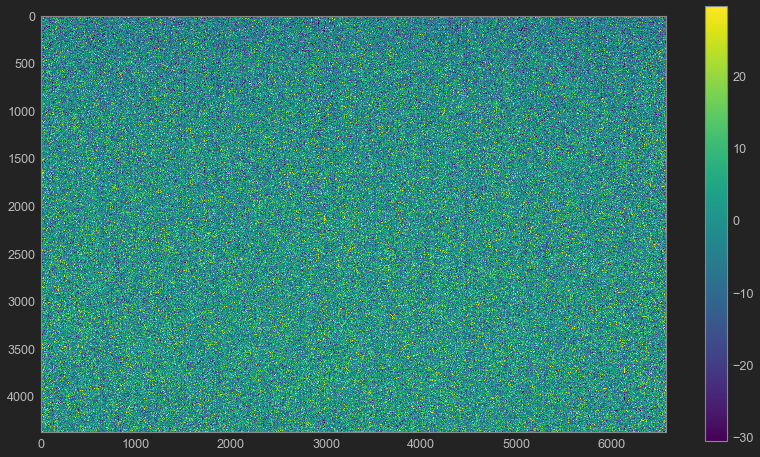

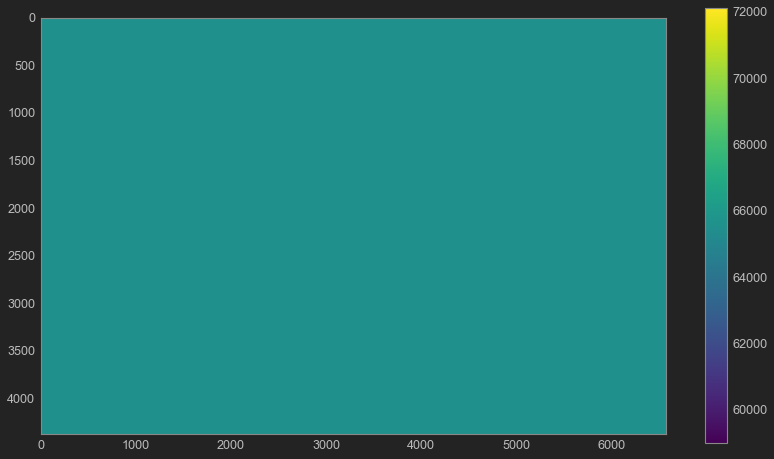

In [418]:
ct.plotimg(set5_bias_mean - set1_mean)
ct.plotimg(set5_light_mean,sig=0.25)

The lights in this data set have been saturated 

In [409]:
warmup_cam1 = pset("warmup",bias=dset("warmup bias",base+"BiasImages/warmup_cam1/"),dark=dset("warmup darks",base+"DarkImages/warmup_cam1/"))
warmup_cam2 = pset("warmup2 flush",bias=dset("warmup bias",base+"BiasImages/warmup_cam2/"),dark=dset("warmup darks",base+"DarkImages/warmup_cam2/"))
warmup_cam2_noflush = pset("warmup2 no flush",bias=dset("warmup bias",base+"BiasImages/warmup_cam2_noflush/"),dark=dset("warmup darks",base+"DarkImages/warmup_cam2_noflush/"))

In [411]:
warmup_cam1.bias.sort_by(warmup_cam1.bias.times)
warmup_cam2.bias.sort_by(warmup_cam2.bias.times)
warmup_cam2_noflush.bias.sort_by(warmup_cam2_noflush.bias.times)
warmup1_bias_mean = ct.master_mean(warmup_cam1.bias.imgs[1:9],[],warmup_cam1.bias.path)
warmup1_dark_mean = ct.master_mean(warmup_cam1.dark.imgs[1:9],[],warmup_cam1.dark.path)
warmup2_bias_mean = ct.master_mean(warmup_cam2.bias.imgs[1:9],[],warmup_cam2.bias.path)
warmup2_dark_mean = ct.master_mean(warmup_cam2.dark.imgs[1:9],[],warmup_cam2.dark.path)
warmup2nf_bias_mean = ct.master_mean(warmup_cam2_noflush.bias.imgs[1:9],[],warmup_cam2_noflush.bias.path)
warmup2nf_dark_mean = ct.master_mean(warmup_cam2_noflush.dark.imgs[1:9],[],warmup_cam2_noflush.dark.path)

note there are two 10 image sets hence why two bias images that are small

(1119.730870739805, 1117.875, 19.19064883380117)
(1143.6166442828987, 1140.875, 111.27276622191972)
(1398.2952312255584, 1396.625, 23.486366408538757)
(1393.130884756334, 1389.25, 170.37140826448766)
(1320.8683852722668, 1319.125, 22.396485319071154)
(1323.2630964205794, 1319.125, 171.80517768825354)


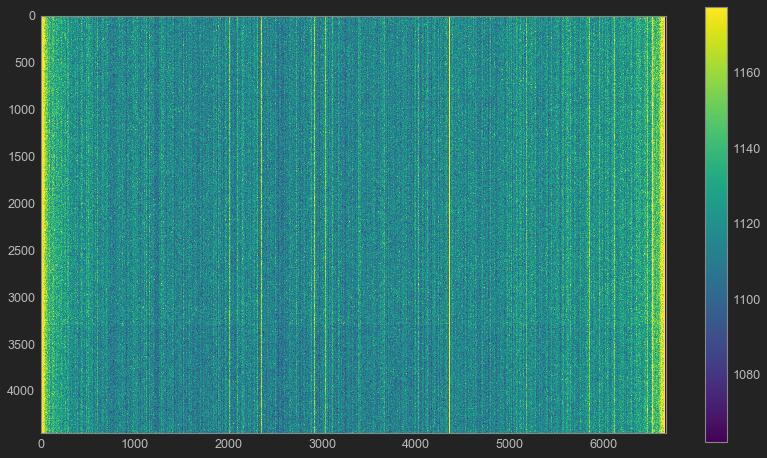

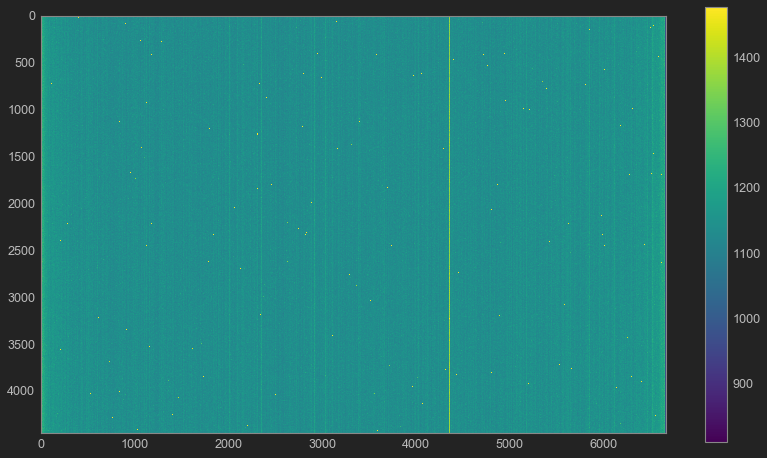

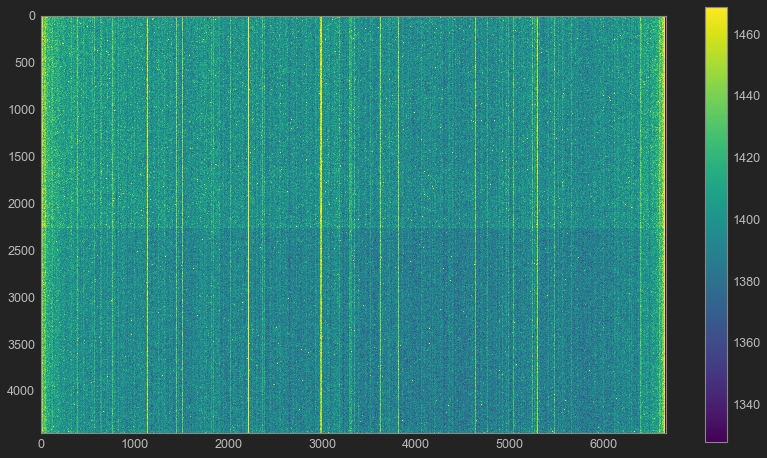

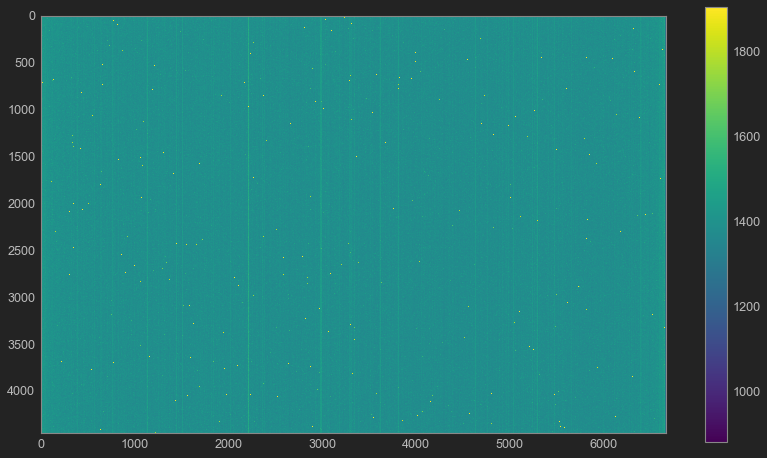

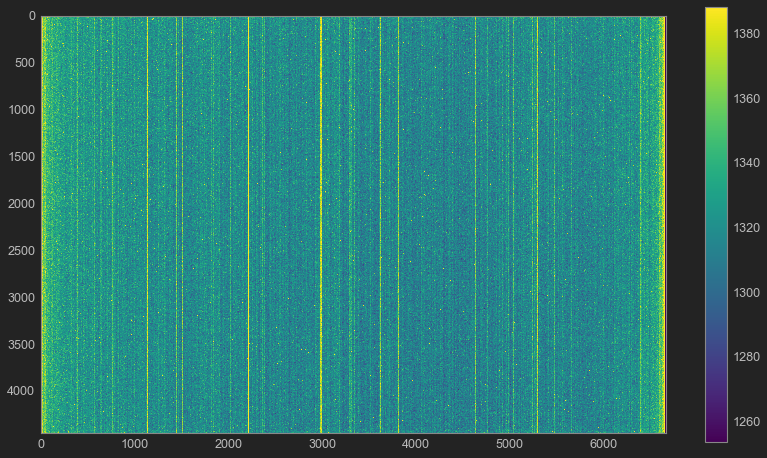

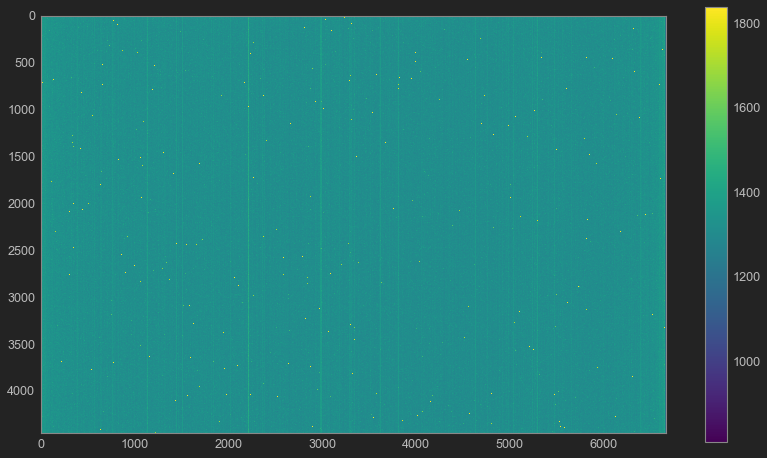

In [412]:
ct.plotimg(warmup1_bias_mean)
ct.plotimg(warmup1_dark_mean)
ct.plotimg(warmup2_bias_mean)
ct.plotimg(warmup2_dark_mean)
ct.plotimg(warmup2nf_bias_mean)
ct.plotimg(warmup2nf_dark_mean)

Note that the preflushgin induced abnormal features in the old cam to which i think heavily indicates that it is a code bug 

### Experimental Procedure (2):
- Take a warm set of 10 bias images with 5 minute waits in between [set 2warm/5]
- Take a warm set of 10 consecutive bias images [set 2warm/c]
- Take 1 300 second dark [set 2warm]
- Set up both cameras in the princeton balcony with the shutter taped and covered via box for additional darkness
- Run the code once with peltier turned off to find out current internal temprature
- Take a set of 10 bias images with 5 minute waits in between [set 2cold/5]
- Take a set of 10 consecutive bias images [set 2cold/c]
- Take 1 300 second dark [set 2col]
- Take 10x 10ms darks with prebias and preflush with varying sleep times after flush [flush]